Preamble, to include the usual suspects.

In [1]:
using LightGraphs
using Plots, GraphPlot, Compose

## rewire!

A function to rewire the edges of a graph net with probability p. That is, every edge has probability p that it will be cut, and (while the source node edg.src is preserved) rewired to a random other destination node

The purpose is to, inconjunction with the lattice constructor that follows construct a 2-D (or n-D) analogue of the Watt-Strogatz model. This is our model of social distancing/shelter-in-place.

In [ ]:
function rewire!(net,p)
    #rewire edges of a graph with probability p
    vert=vertices(net)
    for edg in edges(net) #just do it the slow and literal way - we've got time
        if rand(1)[1]<p
            #rewire
            rem_edge!(net,edg)
            add_edge!(net,edg.src,rand(vert[vert.!=edg.src]))
        end
    end
    return net
end

## Various network constructors

Each of these functions is intended to provide a canned routine to construct a network of pop nodes, with mean degree 4

Although the mean degree is fixed at four, this does not mean that we don't get super-spreader events (ala fullmixing, below). This is also a parameers of conveninece. Other numbers can/could be chosen, but the important thing in these models is really the network topology and not the degrees

Various functions below do the following
1. fullmixing: simulate a full mixing population, no limts on large gatherings and hence potential for superspreaders
2. limitpop: for a given input net, ensure that the degree of no node exceeds some maximum. deleted links are redistributed
3. limitmix: equivalent to limitpop(fullmixing(pop),gth), that is, mass gatherings up to but not exceeding fixed size gth
4. isolation: assume full compliance with "shelter-in-place" nodes exist on a lattice (2-D) and only contact neighbours
5. socialdist: assumes less than perfect compliance with social distancing. That is, same as isolation but with probabilty cmpl of complying. Those that don't comply have long range connections. These are not additional links, just random targets
6. nomassmix: mixing permitted, but no mass gatherings. I.e. mean degree is still four, degree distribution is binomial rather than power-law as in fullmixing

In [126]:
function fullmixing(pop)
    #model a population of pop fully mixed nodes
    #a BA scale-free network model, mean degree 4
    net=barabasi_albert(pop, 3, 2)
    #need to add six extra edges
    verts=vertices(net)
    for i in 1:6
        edg=Edge(rand(verts),rand(verts))
        while edg in edges(net)
            edg=Edge(rand(verts),rand(verts))
        end
        add_edge!(net,edg)
    end
    return net
end

function limitpop(net,gth)
    #prune contact patterns to limit fatherings on net to 
    #no more than gth people. edges are redistributed to preserve mean degree
    nlost=0
    #prune edges from hubs
    for vert in vertices(net)
        neigh=neighbors(net,vert)
        while length(neigh)>gth
            rem_edge!(net,vert,rand(neigh))
            nlost +=1
            neigh=neighbors(net,vert) 
        end
    end
    #redistribute them elsewhere
    vert=vertices(net)
    for i in 1:nlost #will complain if there are not enough edges to add back in
        verts=vert[degree(net).<(gth-1)] 
        v1=rand(verts)
        v2=v1
        while v2==v1
            v2=rand(verts)
        end
        edg=Edge(v1,v2)
        add_edge!(net,edg)
    end
    #maybe a few short, add those too
    while ne(net)<2*pop
        edg=Edge(rand(verts),rand(verts))
        while edg in edges(net)
            edg=Edge(rand(verts),rand(verts))
        end
        add_edge!(net,edg)
    end
    return net
end

function limitmix(pop,gth)
    #model a population of pop fully mixed nodes
    #a BA scale-free network model, mean degree 4
    #No more than gth people
    return limitpop(fullmixing(pop),gth)
end

function isolation(pop)
    #model a population of pop (must be a square number) nodes
    #on a 2D grid, mean degree 4
    spop=Int(floor(sqrt(pop)))
    if abs(spop^2-pop)>0
        spop1=Int(floor(sqrt(pop)))
        spop2=Int(ceil(sqrt(pop)))
        println("population not square ",pop-spop1*spop2," node(s) isolated")
        net=LightGraphs.grid([spop1, spop2], periodic=true)
        add_vertices!(net,pop-spop1*spop2)
    else
        net=LightGraphs.grid([spop, spop], periodic=true)
    end
    return net
end

function socialdist(pop,cmpl)
    #model a population of pop (must be a square number) nodes
    #on a 2D grid, with social distancing compliance cmpl, mean degree 4
    q=1-cmpl^(1/4)  #as elsewhere, this whole thing is assume a mean degree of 4
    net=isolation(pop)
    rewire!(net,q)
    return net
end

function nomassmix(pop)
    #model a population of pop fully mixed nodes - no superspreaders
    #a ER random graph model, mean degree 4
    return erdos_renyi(pop, 2*pop)
end

nomassmix (generic function with 1 method)

## covidsafe

This final constructor is intended to operate on top of the others (an example follows) for a given level of compliance cvd we assume that the contact tracing app (CovidSafe in Australia) is 100% effective and instantaneous. Hence, if there is a transmission between two individuals both of whom have the app, we assume no infection.

In [127]:
function covidsafe(net,cvd)
    #"covidsafe" at fraction cvd effectiveness
    iso=cvd^2 #covidsafe implies removing iso fraction of all edges of graph
    for edg in edges(net)
        if rand(Float64) .< iso
            rem_edge!(net,edg)
        end
    end
    return net
    #unlike the preceeding constructions, this one (and only this one) will reduce the overall degree
end

covidsafe (generic function with 1 method)

## Example

All the contructors above are intended to take either a population or an existing contact network as their argument, some have a secone argument with is a compliance parameter or control restriction (cvd, cmpl, or gth). When required, this is not optional. Certain combinations can be nested, as illustrated below.

This first example, population of 10^4, assume 60% compliance with social distancing and 40% adoption of contact rtracing App.

In [128]:
net=covidsafe(socialdist(100^2,0.6),0.4)

{10000, 17059} undirected simple Int64 graph

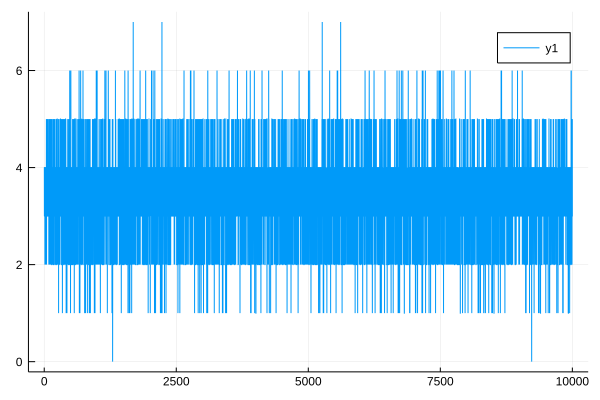

In [129]:
plot(degree(net))

In [130]:
gplot(net)

In [132]:
function getbiggestbit(net)
    #dentify the vertices in the largest connected component of net
    cc=connected_components(net)
    bigi=0
    bign=0
    for i in 1:length(cc)
        if length(cc[i])>bign 
            bign=length(cc[i])
            bigi=i
        end
    end
    return cc[bigi]
end

getbiggestbit (generic function with 1 method)

In [135]:
net=net[getbiggestbit(net)]
ndsz=[length(neighbors(net,vert)) for vert in vertices(net)]
gplot(net, nodefillc=colorant"black",nodesize=ndsz,NODESIZE=pop/10000)

## Another example

This time, 40% adoption of the contact tracing App., but allow mixing and mass gatherings up to but not exceeding 50 people at a time on a population of 10^4.

In [136]:
net=covidsafe(limitmix(100^2,50),0.4)

{10000, 17122} undirected simple Int64 graph

In [138]:
net=net[getbiggestbit(net)]
ndsz=[length(neighbors(net,vert)) for vert in vertices(net)]
gplot(net, nodefillc=colorant"red",nodesize=ndsz,NODESIZE=pop/10000)

## ContactModels.jl

All of these functions (not the graphical bit - that is just showing off) are implemeted in Contact.Models.jl. Just include to use elsewhere. As with EpiSim.jl

### Michael Small 6/6/20